# I. SBND Introduction
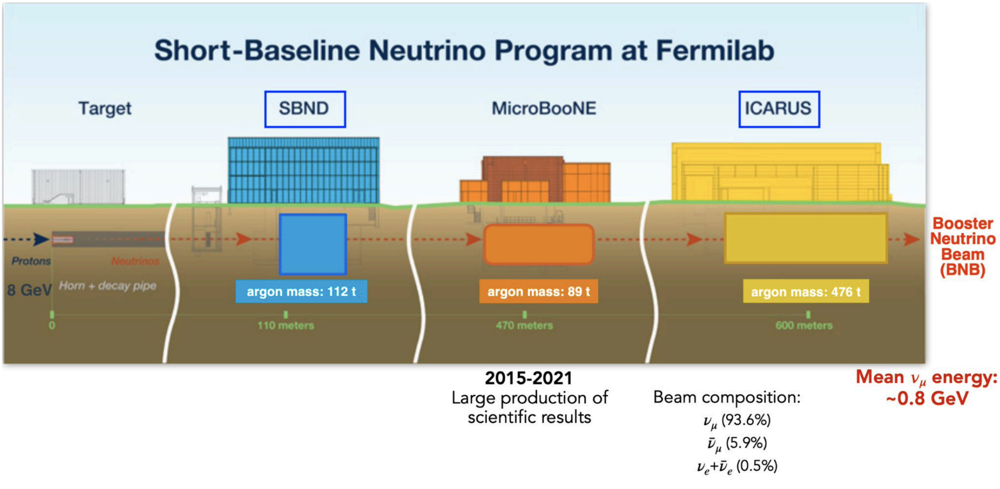
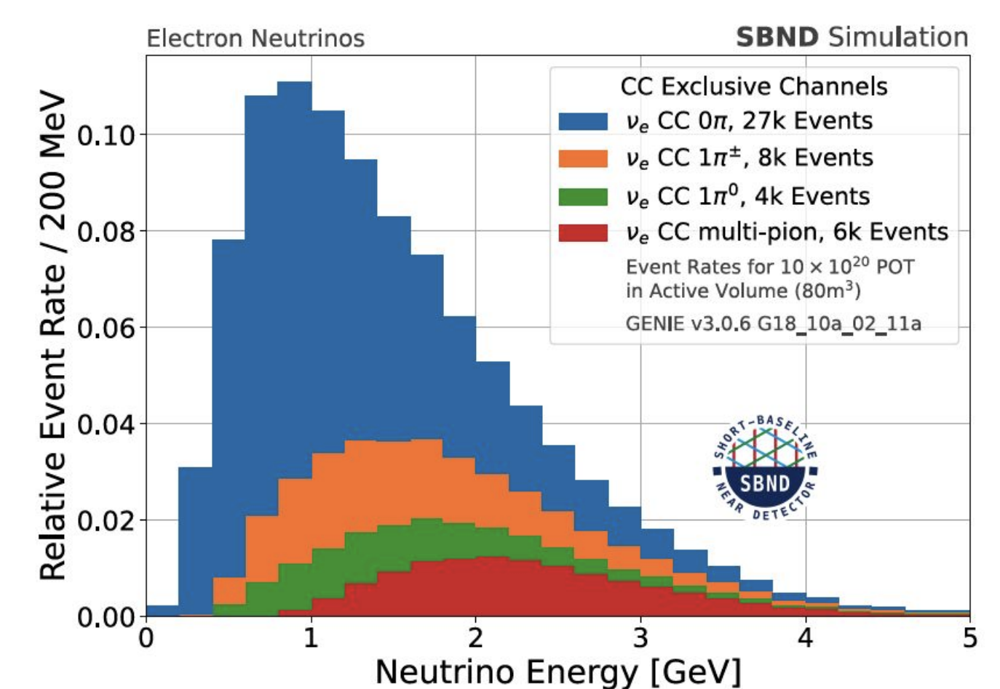 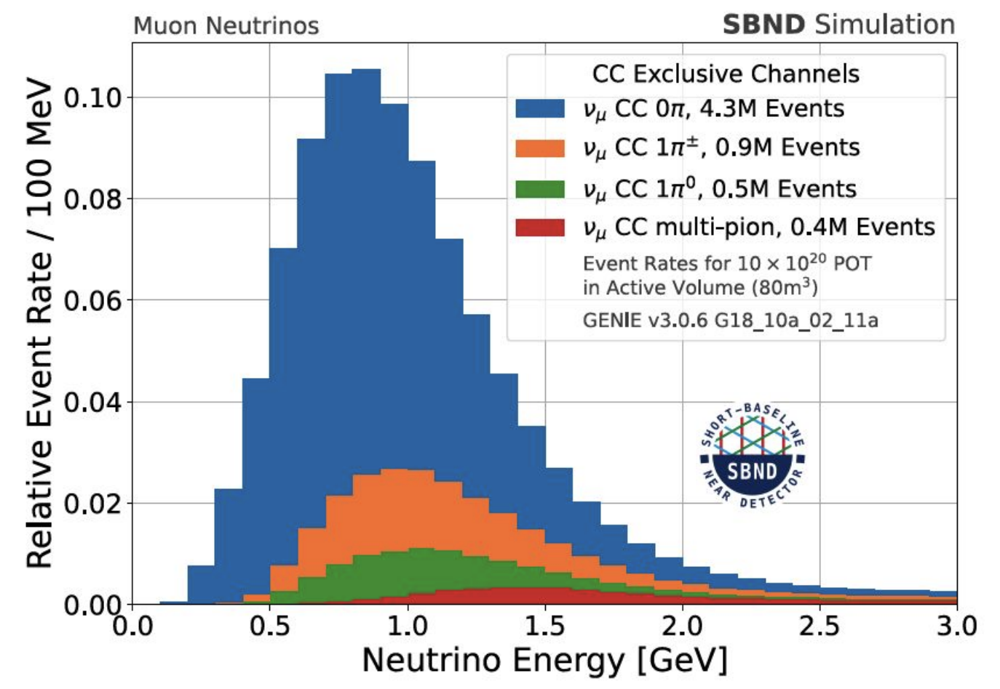
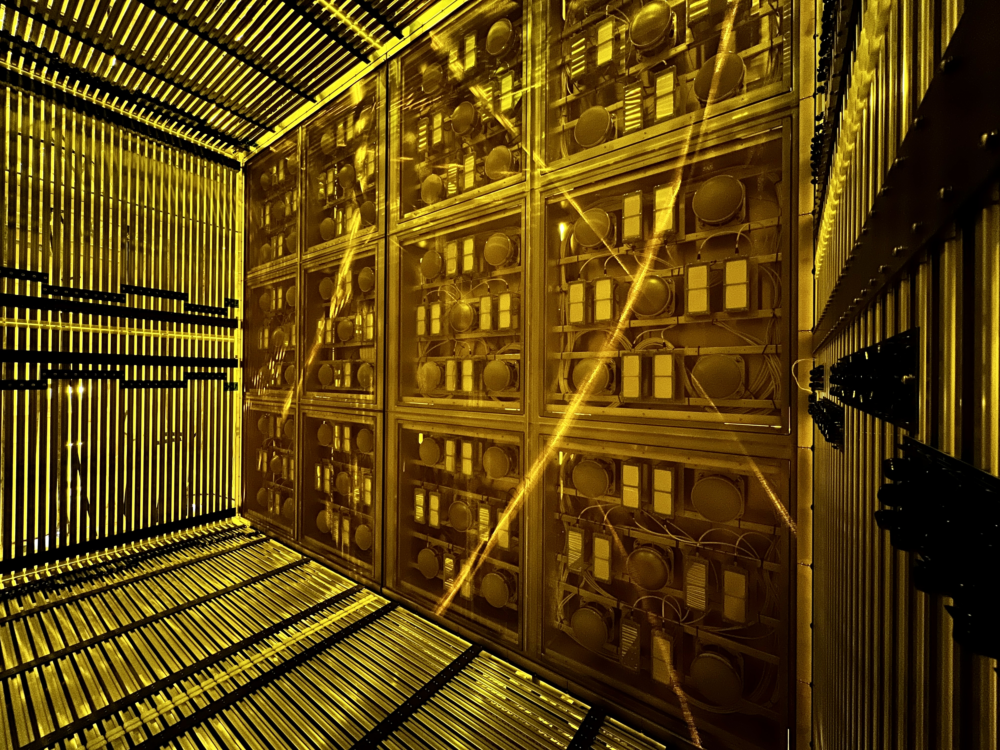

**Main physics goals include cross section measurements, joint oscillation analyses, BSM**

In [1]:
# Basic boilerplate imports
import numpy as np
import pandas as pd
import yaml, os, re, sys

# Visualization Tools
import plotly
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import matplotlib.pyplot as plt
import seaborn as sns

#Autoreload imports
%load_ext autoreload
%autoreload 2

In [2]:
# Set paths
SOFTWARE_DIR = '/sdf/home/b/bearc/lartpc_mlreco3d' #Update to your path
DATA_DIR = '/sdf/group/neutrino/icarus/workshop2023/sbnd_larcv' #Update to /sdf/data/... for s3df
# Set software directory
sys.path.append(SOFTWARE_DIR)

In [3]:
from mlreco.visualization import scatter_points, plotly_layout3d

Welcome to JupyROOT 6.22/08


# 2. Journey to Using Chain

## 2a. MPVMPR
### Producer
MPVMPR generates particle interactions from a vertex (MPV) and cosmic like interactions (MPR). The generation is the same as ICARUS but we use SBND simulation services and multi particle vertex fcl configurations. Additionally, we have one cryostat and two TPCs so we need to update the TPC range.

```
physics.producers.generator.TPCRange     : [[0,0],[0,1]]
physics.producers.rain.TPCRange          : [[0,0],[0,1]]
```



### Geant4
GEANT4 handles secondary interactions of our generated MPVMPR sample. Simenergydeposits is nominally dropped since an ion and scintillation module internal to SBND generates a new simenergydeposit data product, so we need to keep simenergydepositlite.

`Simenergydeposit` - Voxels generated by G4 before detector effects or reference to cluster 3D

```
physics.producers.sedlite.SimEnergyDepositLabel: "largeant:LArG4DetectorServicevolTPCActive"
physics.producers.largeant.StoreDroppedMCParticles: true
physics.producers.mcreco.UseSimEnergyDepositLite: true
physics.producers.mcreco.UseSimEnergyDeposit: false
physics.producers.mcreco.SimChannelLabel: "sedlite"
```

We also need to keep EM shower daughters which is by default false. If EM shower daughters is false some electron voxels are clustered with the primary i.e. delta rays.

<center>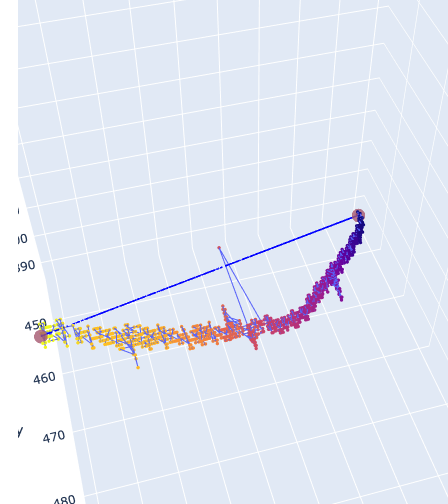</center>
<center>Delta ray clustered with primary track </center>


#### [MPVMPR fcl file](https://github.com/bear-is-asleep/Supera/blob/feature/bearc_sbnd/job/run_mpvmpr_sbnd.fcl) 

## 2b. Cluster 3D + Supera 

### Cluster 3D
Combines information from 3 (2 in the case of doublets which ICARUS and SBND use) readout planes to create voxels if wire information of adjacent hits are compatible. Compatiblility based on SuperaTrue2RecoVoxel3D thresholds. After cluster 3D creates voxels, supera labels voxels as ghost if they don't satisfy the thresholds and non ghost if they do. A UResNet CNN is trained on this voxel wise classification and learns to identify ghost voxels. Cluster3D fcl [file](https://github.com/bear-is-asleep/Supera/blob/feature/bearc_sbnd/job/run_cluster_sbnd.fcl) works out of the box, just need to use SBND services.



In [4]:
from mlreco.main_funcs import process_config, prepare
def make_cfgs(fnames,cfg):
  """
  Make configuration strings from config file
  """
  cfgs = []
  for _,fname in enumerate(fnames):
    cfg_copy = cfg #Make dumby copy
    cfgs.append(cfg_copy.replace('LARCVFILE',fname))
  return cfgs

def load_cfg(cfg,**mlrecoargs):
  """
  return dataset just from cfg
  """
  cfg=yaml.load(cfg,Loader=yaml.Loader)
  # pre-process configuration (checks + certain non-specified default settings)
  process_config(cfg,**mlrecoargs)
  # prepare function configures necessary "handlers"
  hs=prepare(cfg)
  data = next(hs.data_io_iter)
  return data

def load_data_fname(fname,cfg,**mlrecoargs):
  """
  return dataset just from fname
  """
  cfg = make_cfgs([fname],cfg)[0]
  data = load_cfg(cfg,**mlrecoargs)
  return data

In [5]:
sbnd_cfg = './sbnd.cfg'
sbnd_cfg = open(sbnd_cfg, 'r').read().replace('DATA_DIR', DATA_DIR)

#### Bad parameters - poor track completeness

In [6]:
#Specify supera parameters - bad parameters
ne = '100'
tw = '10'
vds = f'{int(tw)/5:.0f}'
pa = '050'
entry = 0

#fname may not exist for some parameters, check data directory
fname = f'larcv_{ne}_{tw}_{vds}_{pa}.root'
data = load_data_fname(fname,sbnd_cfg,verbose=False)

/sdf/home/b/bearc/lartpc_mlreco3d/mlreco/iotools/parsers/cluster.py:210: UserWarning:

You should set `clean_data` to True if you specify a sparse tensor in parse_cluster3d



In [7]:
#Get data from iotool
clust_label_bad = data['cluster_label'][data['cluster_label'][:, 0] == entry]
input_data_bad = data['input_data'][data['input_data'][:, 0] == entry]
segment_label_bad = data['segment_label'][data['segment_label'][:, 0] == entry,-1]
particles_label_bad = data['particles_label'][data['particles_label'][:, 0] == entry]
simenergydeposit_label_bad = data['simenergydeposits'][data['simenergydeposits'][:, 0] == entry]

#### Good parameters - good track completeness

In [8]:
#Specify supera parameters - good parameters
ne = '175'
tw = '5'
vds = f'{int(tw)/5:.0f}'
pa = '450'
entry = 0

#fname may not exist for some parameters, check data directory
fname = f'larcv_{ne}_{tw}_{vds}_{pa}.root'
data = load_data_fname(fname,sbnd_cfg,verbose=False)

/sdf/home/b/bearc/lartpc_mlreco3d/mlreco/iotools/parsers/cluster.py:210: UserWarning:

You should set `clean_data` to True if you specify a sparse tensor in parse_cluster3d



In [9]:
#Get data from iotool
clust_label_good = data['cluster_label'][data['cluster_label'][:, 0] == entry]
input_data_good = data['input_data'][data['input_data'][:, 0] == entry]
segment_label_good = data['segment_label'][data['segment_label'][:, 0] == entry,-1]
particles_label_good = data['particles_label'][data['particles_label'][:, 0] == entry]
simenergydeposit_label_good = data['simenergydeposits'][data['simenergydeposits'][:, 0] == entry]

In [10]:
#Make traces for bad and good parameters
traces_bad = []

traces_bad += scatter_points(simenergydeposit_label_bad,opacity=0.6,color='blue',markersize=1)
traces_bad[-1].name = f'simenergydeposit voxels'

traces_bad += scatter_points(input_data_bad[segment_label_bad<5],opacity=0.6,color=segment_label_bad,markersize=2)
#traces_bad += scatter_points(input_data_bad,opacity=0.6,color=segment_label_bad,markersize=2)
traces_bad[-1].name = f'bad supera parameters (no ghost)'

traces_good = []

traces_good += scatter_points(simenergydeposit_label_good,opacity=0.6,color='blue',markersize=1)
traces_good[-1].name = f'simenergydeposit voxels'

traces_good += scatter_points(input_data_good[segment_label_good<5],opacity=0.6,color=segment_label_good,markersize=2)
#traces_good += scatter_points(input_data_good,opacity=0.6,color=segment_label_good,markersize=2)
traces_good[-1].name = f'good supera parameters (no ghost)'

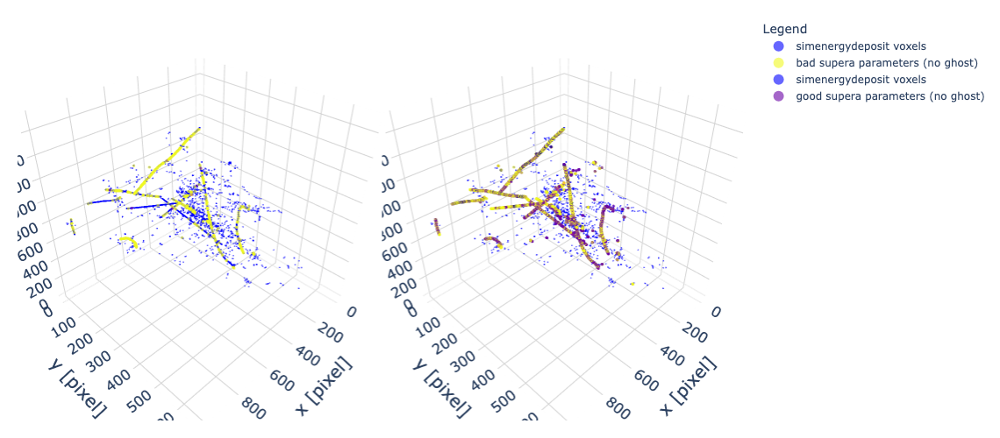

In [11]:
# Template cell for side-by-side event displays
make_plots = True
if make_plots:
    fig = make_subplots(rows=1, cols=2,
                        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}]],
                        horizontal_spacing=0.05, vertical_spacing=0.04)

    fig.add_traces(traces_bad, rows=len(traces_bad) * [1], cols=len(traces_bad) * [1])
    fig.add_traces(traces_good, rows=len(traces_good) * [1], cols=len(traces_good) * [2])

    fig.layout = plotly_layout3d()
    fig.update_layout(showlegend=True,
                      legend=dict(xanchor="left"),
                     autosize=True,
                     height=500,
                     width=1000,
                     margin=dict(r=20, l=20, b=20, t=20))
    iplot(fig)

### SuperaTrue2RecoVoxel3D
Parameters to accept reco voxels. Applies threshold cuts based on following metrics - 
* `Hit number of electrons (Ne)` - Minimum number of electrons within tick window threshold
* `Tick window threshold (tw)` - Time window to accept Ne
* `Voxel distance threshold (vds)` - Conversion between tick window and drift velocity = tw/5
* `Post averaging threshold (pa)` - Lists associated reco voxels, splits true energy evenly between all of them, accepts reco voxels within radius of centroid of associated voxels

SBND optimized parameters with ICARUS parameters in comments

```
SuperaTrue2RecoVoxel3D: {
...
    HitThresholdNe: 175 #100
    HitWindowTicks: 5 #15
    PostAveragingThreshold_cm: 0.425 #0.425
    VoxelDistanceThreshold: 1. #3
}
```



### Other Supera Parameters

Again, we need to tweak the cryostat and tpc config options, since SBND has one cryostat with two TPCs.

```
SuperaMCParticleCluster: {
...
    CryostatList: [0,0]
    TPCList:      [0,1]
}
```

Our geometry is also different so we have to set the bounding region according to our detector geometry. We voxelize our detector into 2048 x 2048 x 2048 voxelized bins. SBND's active volume is centerd at `[0,0,250]` x,y ranging from $\pm$ `200` cm and z ranging from `[0,500]`.

```
SuperaBBoxInteraction: {
...
    BBoxSize:   [614.4, 614.4, 614.4] # 2048 pixels of 0.3 mm
    BBoxBottom: [-307.2, -307.2, -57.4] # centered on the detector center with some padding
    CryostatList: [0,0]
    TPCList:      [0,1]
}
```

In [12]:
all_fnames = os.listdir(DATA_DIR) #larcv_ne_tw_vds_pa.root
all_fnames

['larcv_100_15_3_150.root',
 'larcv_250_10_2_250.root',
 'larcv_100_15_3_500.root',
 'larcv_75_10_2_100.root',
 'larcv_100_10_2_500.root',
 'larcv_100_20_4_250.root',
 'larcv_125_10_2_100.root',
 'larcv_100_20_4_350.root',
 'larcv_100_15_3_100.root',
 'larcv_100_15_3_050.root',
 'larcv_175_5_1_450.root',
 'larcv_50_10_2_100.root',
 'larcv_100_10_2_400.root',
 'larcv_125_10_2_250.root',
 'larcv_100_5_1_100.root',
 'larcv_100_20_4_500.root',
 'larcv_100_20_4_600.root',
 'larcv_125_5_1_100.root',
 'larcv_100_10_2_150.root',
 'larcv_25_10_2_100.root',
 'larcv_25_10_2_425.root',
 'larcv_100_10_2_250.root',
 'larcv_100_20_4_450.root',
 'larcv_100_15_3_300.root',
 'larcv_100_20_4_200.root',
 'larcv_100_10_2_200.root',
 'larcv_100_5_1_425.root',
 'larcv_100_20_4_300.root',
 'larcv_175_10_2_250.root',
 'larcv_75_10_2_250.root',
 'larcv_100_15_3_600.root',
 'larcv_100_10_2_450.root',
 'larcv_100_20_4_100.root',
 'larcv_100_10_2_050.root',
 'larcv_100_15_3_400.root',
 'larcv_100_10_2_350.root',
 

### Matching voxels
Use cKDTree to match voxels. cKDTree[1] spatially partitions recursively and stores points in a tree. Query returns $k$ nearest points (index from the array) and the distances to them. We can then specify the `matching threshold` to accept them as a match.

### Purity/Efficiency
`Purity` describes how many reco voxels are within the matching threshold of a true voxel. `Efficiency` describes how many true voxels are within the matching threshold of a reco voxel.

`purity` =     `reco tagged` / `reco`

`efficiency` = `true tagged` / `true`

[1] https://ceur-ws.org/Vol-2786/Paper28.pdf

In [13]:
from scipy.spatial import cKDTree

def reco_and_true_matching(reco_noghost,true,distance=0):
  """
  Calculates purtiy and efficiency by matching true voxel locations to reco voxel locations
  and vise-versa
  
  
  reco_noghost = xyz coords for nonghost
  true         = xyz for true parts
  distance     = threshold distance between voxels

  eff                 = true tagged voxel count / true voxel count
  pur                 = reco tagged voxel count / reco voxels (noghost)
  reco_tagged         = reco voxels that were matched to a true voxel (true->reco)
  true_tagged         = true voxels that were matched to a reco voxel (reco->true)
  reco_reverse_tagged = reco voxels that were matched to a true voxel (reco->true)
  """
  small = 1e-5 #offset for float precision
  tree = cKDTree(true) #Get tree to perform query
  #Return closest distance to each reco point, and indices of that voxel in the truth array
  distances, indices = tree.query(reco_noghost,k=1)
  reco_indices = []
  for i,d in enumerate(distances): #distances from nearest true voxel
    d-=small
    if d<=distance: #Ignore elements that don't satisfy distance threshold
      reco_indices.append(i)
  reco_tagged = reco_noghost[np.unique(reco_indices)]
  pur = len(reco_tagged)/len(reco_noghost)
  
  #Do it again for efficiency
  tree = cKDTree(reco_noghost) #Get tree to perform query
  #Return closest distance to each reco voxel, and indices of that voxel in the truth array
  distances, indices = tree.query(true,k=1) #Distance from reco to true voxels
  true_indices = []
  reco_tagged_indices = [] #additional index set to store reco points that were matched to true
  for i,d in enumerate(distances):
    d-=small
    if d<=distance: #Ignore elements that don't satisfy the criteria
      true_indices.append(i)
      reco_tagged_indices.append(indices[i])
  reco_reverse_tagged = reco_noghost[np.unique(reco_indices)] #Matched from truth voxel
  true_tagged = true[np.unique(true_indices)]
  eff = len(true_tagged)/len(true)
  
  return pur,eff,reco_tagged,true_indices,reco_tagged_indices,reco_reverse_tagged,reco_indices

In [14]:
#Poorly tuned supera parameters
reco_noghost_bad = input_data_bad[segment_label_bad<5,1:4]
true_bad = simenergydeposit_label_bad[:,1:4]

#SBND tuned supera parameters
reco_noghost_good = input_data_good[segment_label_good<5,1:4]
true_good = simenergydeposit_label_good[:,1:4]

#Matching threshold
distance = np.sqrt(3) #Euclidean distance

In [15]:
pur_bad,eff_bad,_,_,_,_,_ = reco_and_true_matching(reco_noghost_bad,true_bad,distance=distance)
pur_bad,eff_bad

(0.9690346083788707, 0.1677295918367347)

In [16]:
pur_good,eff_good,_,_,_,_,_ = reco_and_true_matching(reco_noghost_good,true_good,distance=distance)
pur_good,eff_good

(0.9134089953762085, 0.8409256559766763)

### Mismatch direction
We can investigate where the voxels are being mismatched and along what axis. Use `cdist` on each point to find the nearest match. The difference along each axis is `reco`-`true`.

In [17]:
from scipy.spatial.distance import cdist

def get_voxel_distances(reco,true):
  """
  Return array of voxel distances between reco and true in x,y,z,total
  Dimensionality of (R,4)
  
  reco = reco noghost voxels
  true = simenergydeposit voxels
  """
  distances = np.zeros((len(reco),4))
  for i,rec in enumerate(reco):
    min_ind = np.argmin(cdist(rec.reshape(1,3),true))
    distances[i,0] = rec[0]-true[min_ind,0]
    distances[i,1] = rec[1]-true[min_ind,1]
    distances[i,2] = rec[2]-true[min_ind,2]
    distances[i,3] = np.min(cdist(rec.reshape(1,3),true))
  return distances

In [18]:
distances = get_voxel_distances(reco_noghost_good,true_good)
reco_distances = np.hstack((reco_noghost_good,distances))
reco_distances[0]

array([219., 262., 219.,   0.,   0.,   0.,   0.])

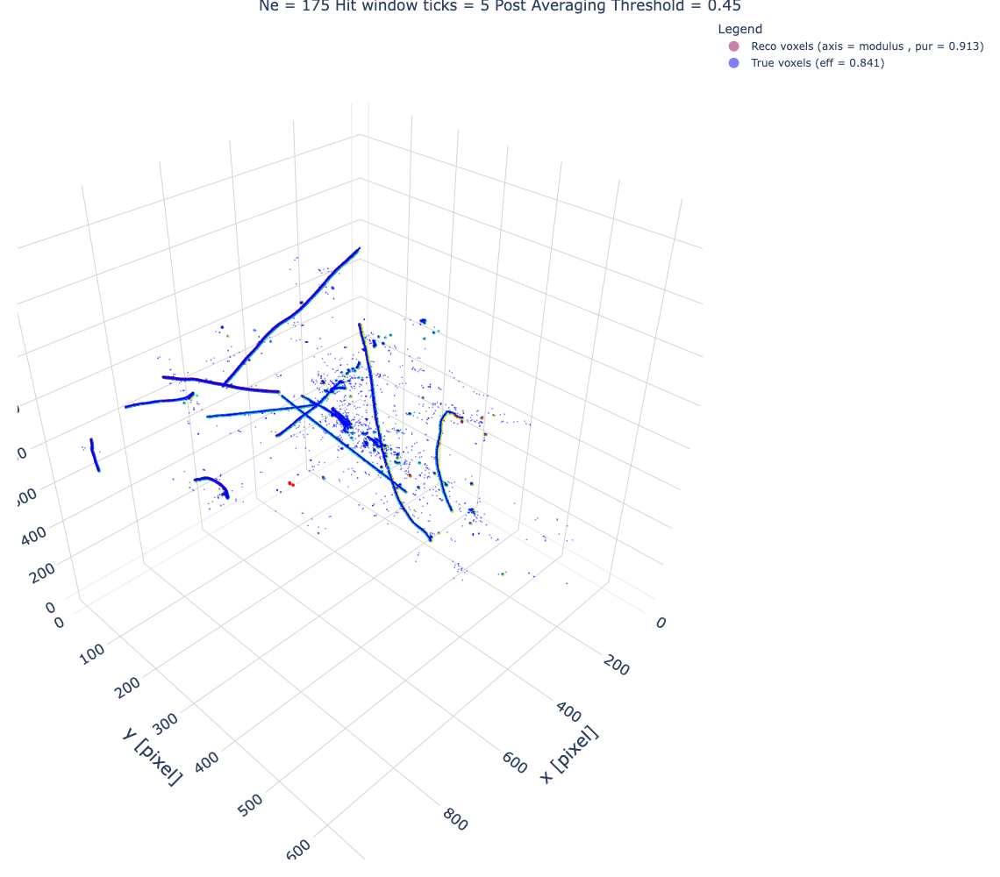

In [19]:
axis = 3
labels=['x','y','z','modulus']

trace = []
#mask = reco_distances[:,3]>np.sqrt(distance)
mask = np.full(len(reco_distances),True)

trace+= scatter_points(reco_distances[mask,0:3],opacity=0.5,
                                   color=reco_distances[mask,axis+3],
                                  colorscale='rainbow',
                                  cmin=0,
                                  cmax=3,
                                  markersize=2
                      )
trace[-1].name = f'Reco voxels (axis = {labels[axis]} , pur = {pur_good:.3f})'

trace+= scatter_points(simenergydeposit_label_good,opacity=0.5,color='blue',markersize=1)
trace[-1].name = f'True voxels (eff = {eff_good:.3f})'

make_plots = True
if make_plots:
    fig = go.Figure(data=trace,layout=plotly_layout3d())

    fig.layout = plotly_layout3d()
    fig.update_layout(showlegend=True,
                      legend=dict(xanchor="left"),
                     autosize=True,
                     height=1000,
                     width=1000,
                     margin=dict(r=20, l=20, b=20, t=20),
                     title={
                       'text': f'Ne = {ne} Hit window ticks = {tw} Post Averaging Threshold = {float(pa)/1e3}','y':1,'x':0.5,
                     })
    iplot(fig)


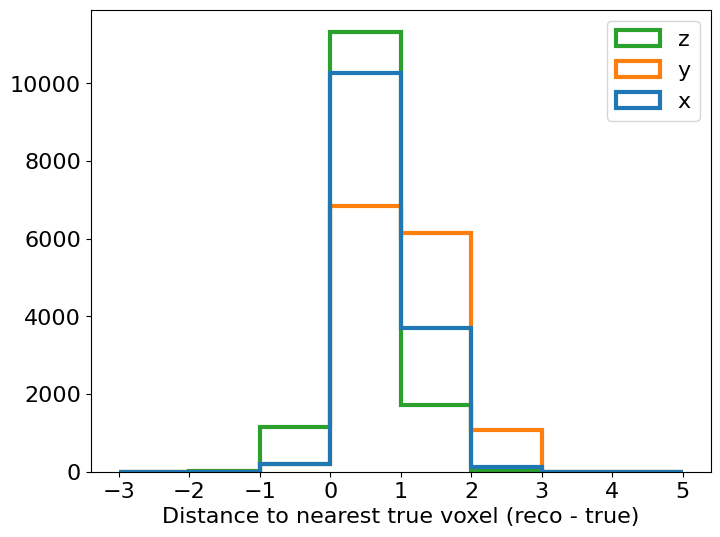

In [20]:
import plotters #my plotting syle
fig,ax = plt.subplots(figsize=(8,6))
ax.hist(reco_distances[:,3:6],label=['x','y','z'],histtype='step',bins=np.arange(-3,6),lw=3)
ax.legend()
ax.set_xlabel('Distance to nearest true voxel (reco - true)')
plotters.set_style(ax)

### Gap Length
Investigate track completeness using third metric - gap length. This metric computes the gaps between clusters of reconstructed voxels belonging to the same cluster ID (use the true cluster ID).

* DBSCAN cluster voxels with Chebyshev metric ($\epsilon$ = 1.1)
* Order clusters along track using PCA
* Calculate intercluster distance $d_{i,i+1}$ between consecutive clusters
* $G=\sum_{i=0}^{n-1}(d_{i,i+1}-\delta)$ , $\delta=1/\textrm{max}_i|\vec{v}|$ where $\vec{v}$ is the track direction
* $\delta$ is meant to account for pixelized nature of voxels, i.e. traveling in just $\hat{z}$ you'd expect the distance to be 1 at maximum. Whereas if you're traveling $\frac{1}{\sqrt{3}} (\hat{x} + \hat{y}+ \hat{z})$ you'd expect the next point to be $\sqrt{3}$ from your point.
* Low $G/L$ indicates better track completeness

In [21]:
def match_input_cluster(clust_label,input_data,drop_duplicates=False,distance_threshold=0):
  """
  match cluster_label to input data using voxel coordinates
  distance_threshold matches voxels within threshold
  return input_data that matches clust_label
  """
  tree = cKDTree(input_data[:,1:4]) #Get tree to perform query
  #Return indices that are on top of the point
  distances, indices = tree.query(clust_label[:,1:4],k=1)
  ret_ind = []
  for d,i in zip(distances,indices):
    if d <= distance_threshold:
      ret_ind.append(i)
  input_data = input_data[ret_ind]
  return input_data
def track_length_calc(line_start,line_end):
  return np.linalg.norm(line_start-line_end)

In [22]:
from sklearn.cluster import DBSCAN
from scipy.spatial.distance import cdist
from sklearn.decomposition import PCA
from mlreco.utils.globals import *

pid = 6 #particle id
eps=1.1 #greater than 1 for float point precision
min_samples=1

#Get particle points
mask = clust_label_good[:,CLUST_COL] == pid
mask_particle = particles_label_good[:,CLUST_COL] == pid
line = particles_label_good[mask_particle,1:4]
points = clust_label_good[mask,1:4]

#Get direction information
direction = (line[0]-line[1])/np.linalg.norm(line[0] - line[1])
gamma = 1/np.sqrt(np.max(abs(direction)))

#DBSCAN with chebyshev clustering
clustering = DBSCAN(eps=eps, min_samples=min_samples, metric='chebyshev').fit(points)
labels = clustering.labels_
unique_labels = np.unique(labels)
centroids = np.array([points[labels == label].mean(axis=0) for label in unique_labels if label != -1])

#ORder along PCA
pca = PCA(n_components=2)
pca.fit(points)
projected_centroids = pca.transform(centroids)
sorted_indices = np.argsort(projected_centroids[:, 0])
cluster_indices = unique_labels[sorted_indices]

#Find distances between adjavent clusters
distances = []
for i in range(1, len(cluster_indices)):
    curr_cluster = points[labels == cluster_indices[i]]
    prev_cluster = points[labels == cluster_indices[i - 1]]
    min_dist = np.min(cdist(curr_cluster,prev_cluster))
    distances.append(min_dist)
    
#Gap length
g = np.sum([d-gamma for d in distances])
track_length = track_length_calc(line[1],line[0])
g,gamma,track_length

(3.200439938257536, 1.0118760130807514, 401.4553687008119)

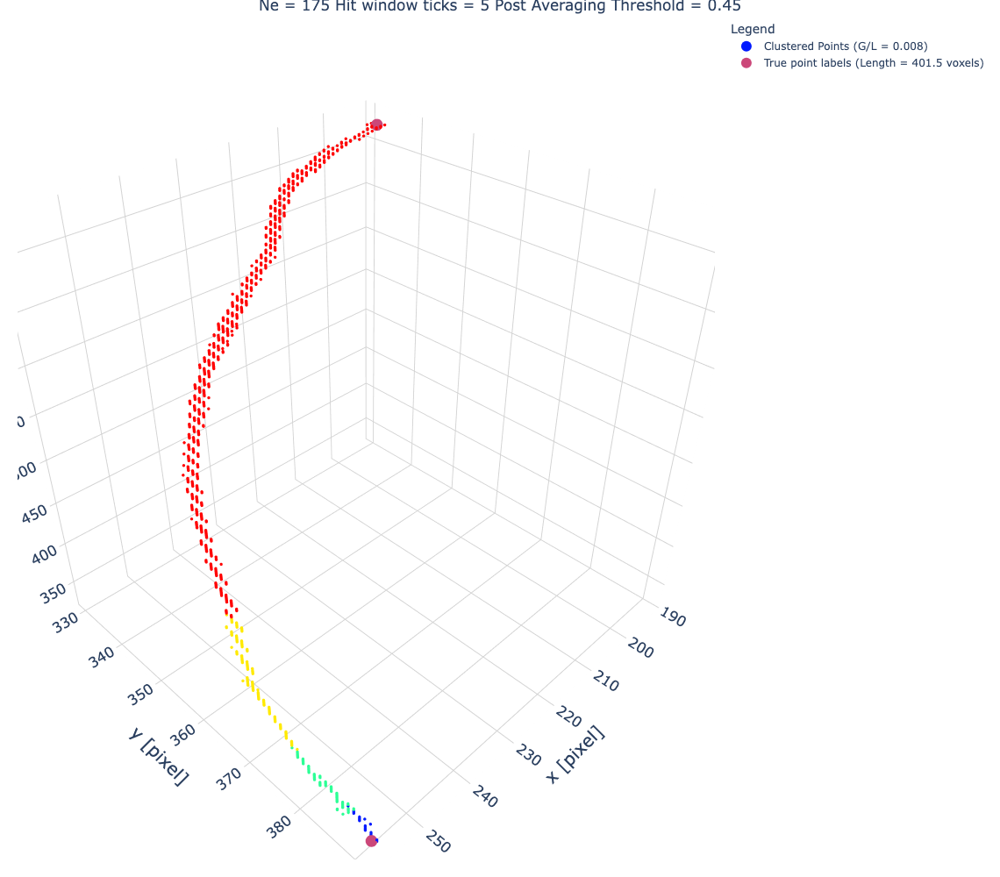

In [23]:
trace = []
trace+= scatter_points(clust_label_good[mask],markersize=2,
                       color=clustering.labels_,
                      colorscale='rainbow',
                       cmin=-1,
                      #mode = 'lines+markers',
                      )
trace[-1].name = f'Clustered Points (G/L = {g/track_length:.3f})'


trace += scatter_points(particles_label_good[mask_particle],
                        markersize=8, 
                        color=particles_label_good[mask_particle, 5], 
                        #mode='markers+lines',
                        line = dict(color=particles_label_good[mask_particle, 5],
                                  width=5))
trace[-1].name = trace[-1].name = f"True point labels (Length = {track_length_calc(line[0],line[1]):.1f} voxels)"

make_plots = True
if make_plots:
    fig = go.Figure(data=trace,layout=plotly_layout3d())

    fig.layout = plotly_layout3d()
    fig.update_layout(showlegend=True,
                      legend=dict(xanchor="left"),
                     autosize=True,
                     height=1000,
                     width=1000,
                     margin=dict(r=20, l=20, b=20, t=20),
                     title={
                       'text': f'Ne = {ne} Hit window ticks = {tw} Post Averaging Threshold = {float(pa)/1e3}','y':1,'x':0.5,
                     })
    iplot(fig)

### Parameter Selection
We calculate `pur`, `eff`, and `track completeness` for each set of supera parameters and hand scan for best metrics.

In [25]:
import pickle
with open('matching_dict.pkl', 'rb') as handle:
    matching_dict = pickle.load(handle)

In [27]:
#matching_dict[key] = [ne,tw,vds,pa,dist,pur,eff,distance_dict,dQ_dx,dN_dx,dE_dx,gap_l]
distance = 3
nes = []
tws = []
vds = []
pas = []
purs = []
effs = []
dQs = []
dNs = []
dEs = []
gaps = []


for key,value in matching_dict.items():
    if matching_dict[key][4] == distance:
        #print (matching_dict[key][0:5])
        nes.append(matching_dict[key][0])
        tws.append(matching_dict[key][1])
        vds.append(matching_dict[key][2])
        pas.append(matching_dict[key][3])
        purs.append(matching_dict[key][5])
        effs.append(matching_dict[key][6])
        dQs.append(matching_dict[key][8])
        dNs.append(matching_dict[key][9])
        dEs.append(matching_dict[key][10])
        gaps.append(matching_dict[key][11])
        
#Convert to numpy
nes = np.array(nes)
tws = np.array(tws)
vds = np.array(vds)
pas = np.array(pas)
purs = np.array(purs)
effs = np.array(effs)
dQs = np.array(dQs)
dNs = np.array(dNs)
dEs = np.array(dEs)
gaps = np.array(gaps)
pur_effs = purs*effs

#Sort by descending post averaging threshold
inds = np.argsort(-pas)
nes = nes[inds]
tws = tws[inds]
vds = vds[inds]
pas = pas[inds]
purs = purs[inds]
effs = effs[inds]
dQs = dQs[inds]
dNs = dNs[inds]
dEs = dEs[inds]
gaps = gaps[inds]
pur_effs = pur_effs[inds]

In [28]:
def plot_pur_eff_hyperparams(purs,effs,nes,tws,vds,pat=None,**kwargs):
  """
  Plot pur, eff vs hyperparams
  """
  x = np.arange(len(purs)) #Get x values
  tick_labels = [''] #Store tick labels
  print(len(nes),len(purs))
  for i,ne in enumerate(nes):
    if pat is None:
      tick = fr'{ne} $N_e$ , {tws[i]} TW , {vds[i]} vds'
    else: 
      tick = fr'{ne} $N_e$ , {tws[i]} TW , {vds[i]} vds, {pat[i]/1e3:.3f} pa'
    tick_labels.append(tick)
  fig, ax = plt.subplots(figsize=(6,12))
  ax.plot(purs,x,color='red',label='Purity', **kwargs)
  ax.plot(effs,x,color='blue',label='Efficiency',**kwargs)
  ax.plot(effs*purs,x,color='green',label=r'P$\times$E',**kwargs)
  ax.axhline(np.argmax(effs*purs),ls='--',color='black')
  ax.set_yticks(x)
  ax.set_yticklabels(tick_labels[1:],rotation=00)
  ax.legend()
  ax.set_xlabel('Pur/Eff')
  return fig,ax
  

60 60


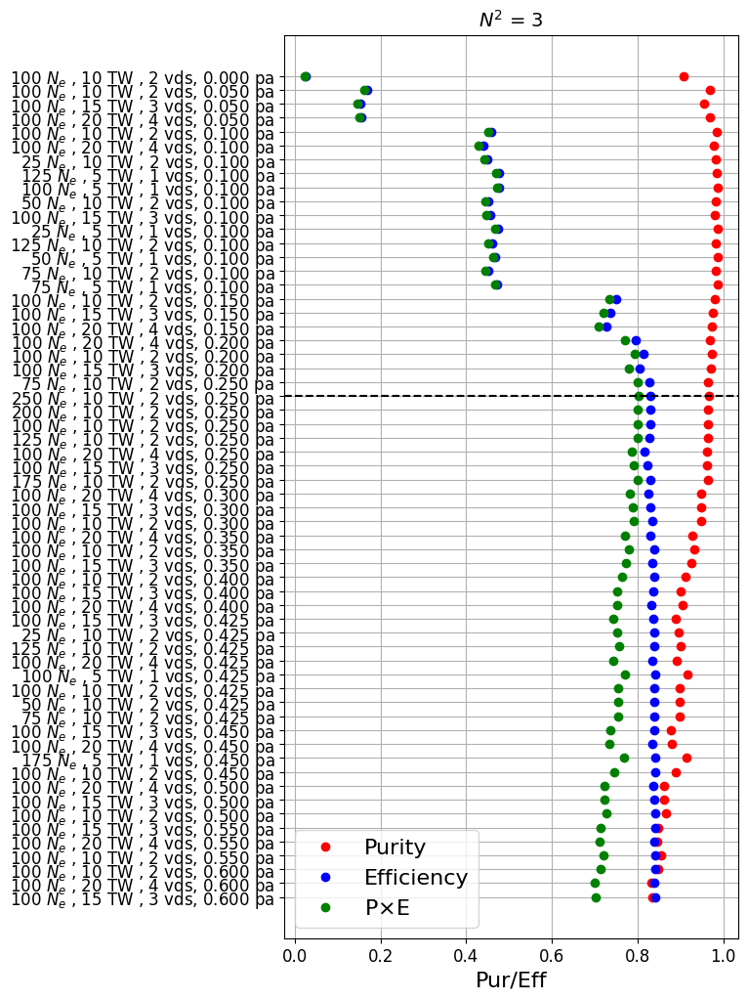

In [29]:
fig,ax = plot_pur_eff_hyperparams(purs,effs,nes,tws,vds,pas,marker='o',linestyle='')
ax.set_title(fr'$N^2$ = {distance}')
ax.grid()
plotters.set_style(ax,title_size=14,tick_size=12)
plt.show()

In [30]:
def plot_metric_hyperparams(metric,label,nes,tws,vds,pat=None,**kwargs):
  """
  Plot pur, eff vs hyperparams
  """
  x = np.arange(len(metric)) #Get x values
  tick_labels = [''] #Store tick labels
  for i,ne in enumerate(nes):
    if pat is None:
      tick = fr'{ne} $N_e$ , {tws[i]} TW , {vds[i]} vds'
    else: 
      tick = fr'{ne} $N_e$ , {tws[i]} TW , {vds[i]} vds, {pat[i]/1e3:.3f} pa'
    tick_labels.append(tick)
  fig, ax = plt.subplots(figsize=(6,12))
  ax.plot(metric,x, **kwargs)
  ax.axhline(np.argmin(metric),ls='--',color='black')
  ax.set_yticks(x)
  ax.set_yticklabels(tick_labels[1:],rotation=00)
  ax.set_xlabel(label)
  
  return fig,ax

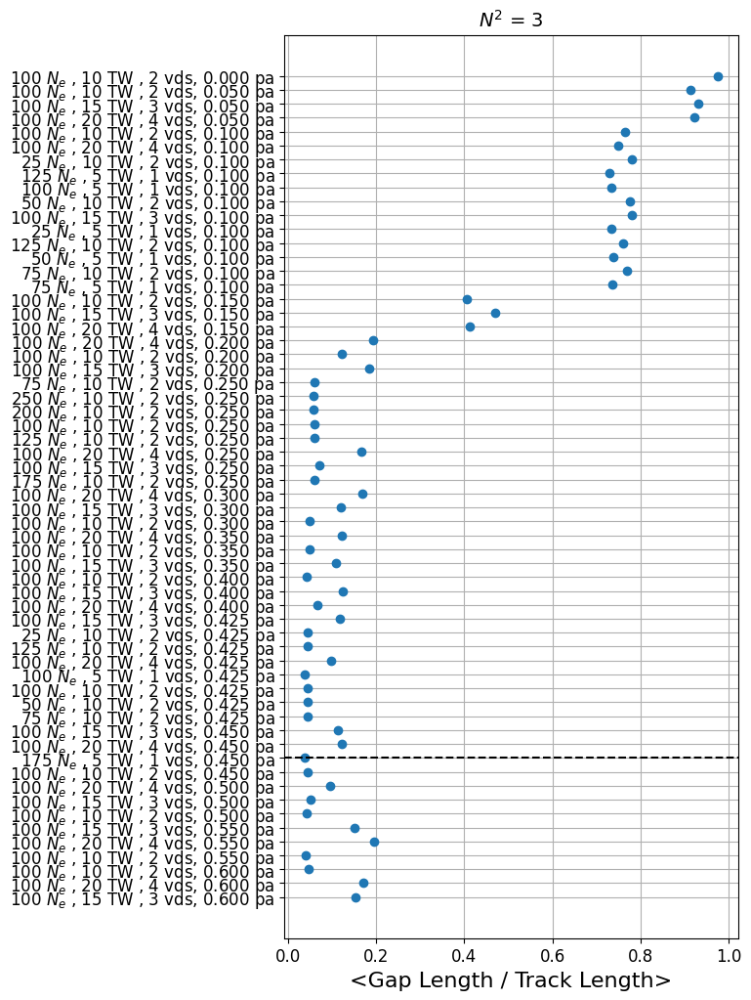

In [31]:
fig,ax = plot_metric_hyperparams(gaps,'<Gap Length / Track Length>',nes,tws,vds,pas,marker='o',linestyle='')
ax.set_title(fr'$N^2$ = {distance}')
ax.grid()
plotters.set_style(ax,title_size=14,tick_size=12)
plt.show()

### Exercise
* Compute dE,dQ,dN dx
* Plot dE,dQ,dN vs. vx
* Fix supera
* Buy me dinner